<a href="https://colab.research.google.com/github/OJB-Quantum/Notebooks-for-Ideas/blob/main/Bloch_Sphere_YZ_Rotation_Animation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Bloch Sphere Rotation Animation — Y(θ) then Z(φ)

**Sequence:** Start at $|0\rangle$ → rotate by **θ = π/4** about **Y** → *(pause)* → rotate by **φ = π** about **Z** → *stop*.

This Colab-ready notebook:
- animates the Bloch vector on a sphere,
- prints the **final quantum state** (amplitudes), the **probabilities** $P(|0\rangle), P(|1\rangle)$,
- and the **relative phase** $\Delta = \arg(\beta) - \arg(\alpha)$.

Use `set_data_3d([...])` for the moving point and `blit=False` for 3D animation.


## What is happening?
A **qubit** is like a tiny arrow living on a ball called the **Bloch sphere**.  
- Pointing straight up means the qubit is in the state $|0\rangle$.  
- Turning the arrow around the **Y-axis** by an angle θ moves it away from the top.  
- Then spinning it around the **Z-axis** by an angle φ changes its **phase**, which is a kind of angle that does not change the up-vs-down probabilities but does change the arrow’s direction around the equator.  
We will rotate by **θ = π/4** about Y, pause, then rotate by **φ = π** about Z, and then read off the final probabilities and the phase.

## What is happening? (Graduate level view)
Starting from $|\psi_0\rangle = |0\rangle$, we apply $R_y(\theta) = e^{-i\theta\sigma_y/2}$ followed by $R_z(\phi) = e^{-i\phi\sigma_z/2}$.  
Thus, the final state is $|\psi_f\rangle = R_z(\phi) R_y(\theta) |0\rangle$.  
On the Bloch sphere, the first rotation changes the **polar** angle to $\theta$ while keeping **azimuth** $\varphi = 0$; the second rotation advances the azimuth by $\phi$, preserving the polar angle.  
Amplitudes $(\alpha,\beta)$ give $P(|0\rangle)=|\alpha|^2$, $P(|1\rangle)=|\beta|^2$. The physically relevant phase is the **relative phase** $\Delta = \arg(\beta)-\arg(\alpha)$ (global phase is unobservable).  

## Adjustable Parameters

In [7]:

# @title Parameters
# You can change these and re-run the animation cell.
import math

THETA = math.pi / 4    # @param {type:"raw"}  # Y-rotation
PHI   = math.pi        # @param {type:"raw"}  # Z-rotation

# Animation controls
FRAMES_Y = 90          # @param {type:"integer"}
FRAMES_Z = 90          # @param {type:"integer"}
PAUSE_FRAMES = 18      # @param {type:"integer"}
INTERVAL_MS = 30       # @param {type:"integer"}
SPHERE_RES = 60        # @param {type:"integer"}  # sphere mesh resolution

SAVE_MP4 = True       # @param {type:"boolean"}
MP4_PATH = "bloch_yz_rotation.mp4"  # @param {type:"string"}

assert THETA >= 0.0
assert PHI >= 0.0


## Core Module: `bloch_anim_core.py` (fixed)

In [8]:

# Write the fixed core module to a file.
MODULE_PATH = "bloch_anim_core.py"
MODULE_CODE = r'''
# bloch_anim_core.py  (v2 - fixed)
# A small, well-documented module for Bloch-sphere animation and state analysis.
# Designed for Google Colab: matplotlib 3D + JSHTML animation.

from __future__ import annotations

from typing import Tuple
import math
import cmath
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401  (ensures 3D projection is registered)
import pandas as pd

# Matplotlib display hint: use JSHTML for animations in notebooks
plt.rcParams["figure.dpi"] = 180
plt.rcParams["animation.html"] = "jshtml"


def ry(theta: float) -> np.ndarray:
    """
    Rotation about Y: R_y(theta) = exp(-i * theta * sigma_y / 2).
    For qubits, this has a real-valued representation:
        [[ cos(theta/2), -sin(theta/2) ],
         [ sin(theta/2),  cos(theta/2) ]]
    """
    c = math.cos(theta / 2.0)
    s = math.sin(theta / 2.0)
    return np.array([[c, -s], [s, c]], dtype=complex)


def rz(phi: float) -> np.ndarray:
    """
    Rotation about Z: R_z(phi) = exp(-i * phi * sigma_z / 2)
                      = diag(e^{-i phi/2}, e^{+i phi/2}).
    """
    a = cmath.exp(-1j * phi / 2.0)
    b = cmath.exp(+1j * phi / 2.0)
    return np.array([[a, 0.0], [0.0, b]], dtype=complex)


def normalize(state: np.ndarray) -> np.ndarray:
    """Return state / ||state||, robust to tiny rounding."""
    norm = np.linalg.norm(state)
    if norm == 0.0:
        raise ValueError("Zero-norm state encountered.")
    return state / norm


def state_after_rotations(theta: float, phi: float,
                          init_state: np.ndarray | None = None) -> np.ndarray:
    """
    Compute |psi_f> = R_z(phi) R_y(theta) |psi_0>.
    Default initial state: |0> = [1, 0]^T.
    """
    if init_state is None:
        init_state = np.array([1.0 + 0.0j, 0.0 + 0.0j], dtype=complex)
    return normalize(rz(phi) @ (ry(theta) @ init_state))


def bloch_vector_from_state(state: np.ndarray) -> Tuple[float, float, float]:
    """
    Convert a qubit state |psi> = (alpha, beta) to Bloch vector (x, y, z):
      x = 2 Re(alpha* conj(beta))
      y = 2 Im(alpha* conj(beta))
      z = |alpha|^2 - |beta|^2
    """
    alpha, beta = state[0], state[1]
    ab_conj = alpha * np.conjugate(beta)
    x = 2.0 * ab_conj.real
    y = 2.0 * ab_conj.imag
    z = (abs(alpha) ** 2) - (abs(beta) ** 2)
    return float(x), float(y), float(z)


def generate_bloch_path(theta: float, phi: float,
                        frames_y: int, frames_z: int,
                        pause_frames: int) -> np.ndarray:
    """
    Generate a piecewise path on the Bloch sphere:
      1) Y-rotation from 0 -> theta (phi=0)
      2) Pause (hold at theta)
      3) Z-rotation from 0 -> phi (theta fixed)

    Returns: array of shape (N, 3) with (x,y,z) for each frame.
    """
    # Segment 1: rotate about Y, starting at north pole (theta=0 -> theta)
    # On Bloch sphere: for phi=0,
    #   x = sin(theta_frame), y = 0, z = cos(theta_frame)
    t_vals = np.linspace(0.0, theta, max(frames_y, 1))
    seg1 = np.column_stack((np.sin(t_vals), np.zeros_like(t_vals), np.cos(t_vals)))

    # Segment 2: pause at fixed theta
    if pause_frames > 0:
        pause = np.tile(seg1[-1], (pause_frames, 1))
        seg2 = pause
    else:
        seg2 = np.zeros((0, 3))

    # Segment 3: rotate about Z by advancing azimuth phi, holding polar angle at theta
    #   x = sin(theta) * cos(phi_frame), y = sin(theta) * sin(phi_frame), z = cos(theta)
    p_vals = np.linspace(0.0, phi, max(frames_z, 1))
    st = math.sin(theta)
    ct = math.cos(theta)
    x3 = st * np.cos(p_vals)
    y3 = st * np.sin(p_vals)
    z3 = np.full_like(p_vals, ct)
    seg3 = np.column_stack((x3, y3, z3))

    path = np.vstack((seg1, seg2, seg3))
    return path


def build_bloch_sphere(ax: plt.Axes, sphere_res: int = 60) -> None:
    """
    Draw a translucent Bloch sphere, axes, and equator.
    """
    # Sphere surface
    u = np.linspace(0.0, 2.0 * math.pi, sphere_res)
    v = np.linspace(0.0, math.pi, sphere_res)
    xs = np.outer(np.cos(u), np.sin(v))
    ys = np.outer(np.sin(u), np.sin(v))
    zs = np.outer(np.ones_like(u), np.cos(v))
    ax.plot_surface(xs, ys, zs, rstride=2, cstride=2, alpha=0.08, linewidth=0.25, edgecolor="k")

    # Axes
    ax.plot([-1, 1], [0, 0], [0, 0], lw=1.0)  # X
    ax.plot([0, 0], [-1, 1], [0, 0], lw=1.0)  # Y
    ax.plot([0, 0], [0, 0], [-1, 1], lw=1.0)  # Z

    # Equator
    phi = np.linspace(0.0, 2.0 * math.pi, 200)
    ax.plot(np.cos(phi), np.sin(phi), np.zeros_like(phi), lw=0.8, alpha=0.8)

    # Formatting
    ax.set_box_aspect([1, 1, 1])
    ax.set_xlim([-1.0, 1.0])
    ax.set_ylim([-1.0, 1.0])
    ax.set_zlim([-1.0, 1.0])
    ax.set_xticks([-1, -0.5, 0, 0.5, 1])
    ax.set_yticks([-1, -0.5, 0, 0.5, 1])
    ax.set_zticks([-1, -0.5, 0, 0.5, 1])
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.view_init(elev=22, azim=35)


def make_animation(theta: float, phi: float,
                   frames_y: int = 90, frames_z: int = 90,
                   pause_frames: int = 18, interval_ms: int = 30,
                   sphere_res: int = 60):
    """
    Construct the figure and a FuncAnimation that traces the Y-then-Z path.
    Returns: (fig, anim, final_state).
    """
    path = generate_bloch_path(theta, phi, frames_y, frames_z, pause_frames)

    fig = plt.figure(figsize=(6, 6))
    ax = fig.add_subplot(111, projection="3d")
    build_bloch_sphere(ax, sphere_res=sphere_res)

    # Trajectory line and moving point
    traj, = ax.plot([], [], [], lw=2.0)
    point, = ax.plot([], [], [], "o", markersize=6)

    title = ax.set_title("Bloch Sphere: Y(θ) then Z(φ)")

    def init():
        traj.set_data([], [])
        traj.set_3d_properties([])
        # Moving point requires sequences for x, y, z:
        point.set_data_3d([], [], [])
        title.set_text("Bloch Sphere: Y(θ) then Z(φ)")
        return traj, point, title

    def update(frame: int):
        xyz = path[: frame + 1, :]
        traj.set_data(xyz[:, 0], xyz[:, 1])
        traj.set_3d_properties(xyz[:, 2])

        # Use sequences (lists) for the single moving point.
        x, y, z = xyz[-1, 0], xyz[-1, 1], xyz[-1, 2]
        point.set_data_3d([x], [y], [z])

        # Phase of animation title
        total_frames = path.shape[0]
        if frame < len(path) - (frames_z + 1):
            phase = "Y-rotation"
        elif frame < len(path) - 1:
            phase = "Z-rotation"
        else:
            phase = "Done"
        title.set_text(f"Bloch Sphere: Y(θ) then Z(φ) — {phase} ({frame+1}/{total_frames})")
        return traj, point, title

    anim = animation.FuncAnimation(
        fig, update, init_func=init, frames=path.shape[0], interval=interval_ms, blit=False
    )

    final_state = state_after_rotations(theta, phi)
    return fig, anim, final_state


def state_results_table(state: np.ndarray) -> pd.DataFrame:
    """
    Return a full table with amplitudes, magnitudes, probabilities, and phases for (alpha, beta),
    plus the relative phase Δ = arg(beta) - arg(alpha).
    """
    alpha = complex(state[0])
    beta = complex(state[1])

    def phase_rad(z: complex) -> float:
        return float(cmath.phase(z))

    def phase_deg(z: complex) -> float:
        return math.degrees(phase_rad(z))

    rel_phase = phase_rad(beta) - phase_rad(alpha)
    # Normalize to (-pi, pi]
    rel_phase = (rel_phase + math.pi) % (2.0 * math.pi) - math.pi
    rel_phase_deg = math.degrees(rel_phase)

    rows = []
    rows.append({
        "Component": "alpha (|0>)",
        "Amplitude (complex)": f"{alpha.real:+.12f}{alpha.imag:+.12f}j",
        "Magnitude": f"{abs(alpha):.12f}",
        "Probability": f"{abs(alpha)**2:.12f}",
        "Phase (rad)": f"{phase_rad(alpha):+.12f}",
        "Phase (deg)": f"{phase_deg(alpha):+.12f}",
    })
    rows.append({
        "Component": "beta (|1>)",
        "Amplitude (complex)": f"{beta.real:+.12f}{beta.imag:+.12f}j",
        "Magnitude": f"{abs(beta):.12f}",
        "Probability": f"{abs(beta)**2:.12f}",
        "Phase (rad)": f"{phase_rad(beta):+.12f}",
        "Phase (deg)": f"{phase_deg(beta):+.12f}",
    })
    rows.append({
        "Component": "Relative phase Δ = arg(β) - arg(α)",
        "Amplitude (complex)": "—",
        "Magnitude": "—",
        "Probability": "—",
        "Phase (rad)": f"{rel_phase:+.12f}",
        "Phase (deg)": f"{rel_phase_deg:+.12f}",
    })
    df = pd.DataFrame(rows, columns=[
        "Component", "Amplitude (complex)", "Magnitude", "Probability", "Phase (rad)", "Phase (deg)"
    ])
    return df
'''

with open(MODULE_PATH, "w", encoding="utf-8") as f:
    f.write(MODULE_CODE)

print(f"Wrote {MODULE_PATH} ({len(MODULE_CODE.splitlines())} lines).")

Wrote bloch_anim_core.py (254 lines).


## Lint the module with Pylint

In [9]:
# Pylint is typically pre-installed on Colab. If not, this will install it.
import sys
import subprocess

def _maybe_install(pkg: str) -> None:
    try:
        __import__(pkg)
    except Exception:  # pylint: disable=broad-except
        print(f"Installing {pkg} ...")
        subprocess.run([sys.executable, "-m", "pip", "install", "-q", pkg], check=False)

_maybe_install("pylint")

print("Running: pylint --score=y bloch_anim_core.py")
subprocess.run([sys.executable, "-m", "pylint", "--score=y", "bloch_anim_core.py"], check=False)

Running: pylint --score=y bloch_anim_core.py


CompletedProcess(args=['/usr/bin/python3', '-m', 'pylint', '--score=y', 'bloch_anim_core.py'], returncode=28)

## Animate the Y-then-Z Rotation

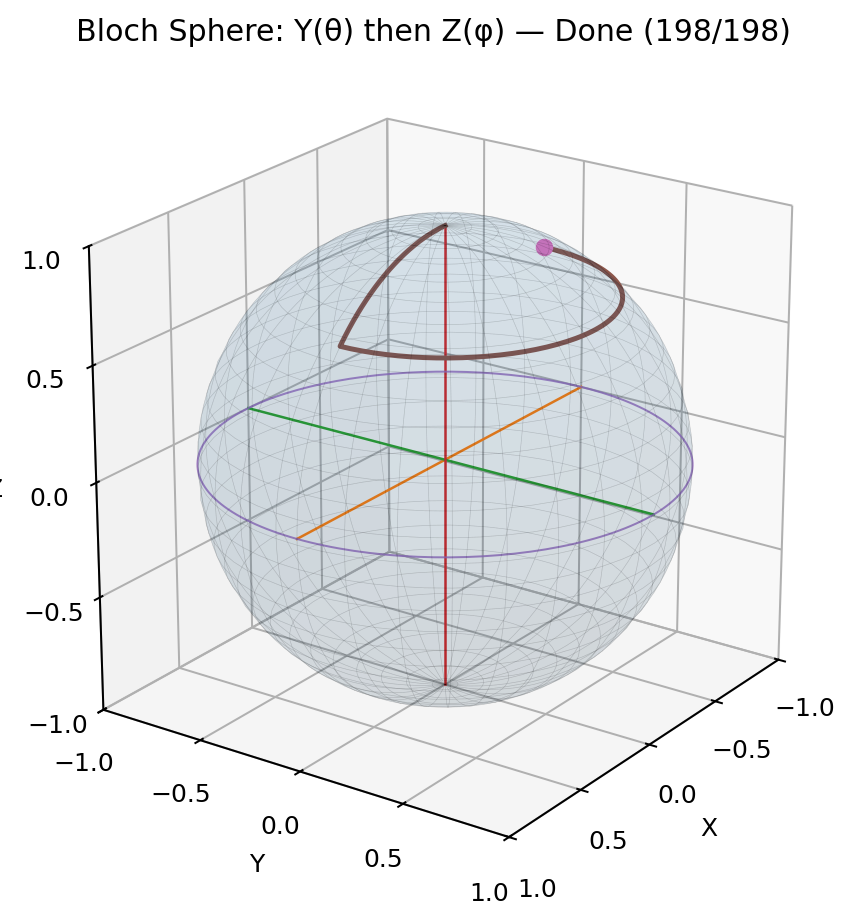

In [10]:
from IPython.display import HTML
import matplotlib as mpl
from bloch_anim_core import make_animation

mpl.rcParams["animation.html"] = "jshtml"  # ensure JSHTML display

fig, anim, FINAL_STATE = make_animation(
    theta=THETA, phi=PHI,
    frames_y=FRAMES_Y, frames_z=FRAMES_Z,
    pause_frames=PAUSE_FRAMES, interval_ms=INTERVAL_MS,
    sphere_res=SPHERE_RES
)

HTML(anim.to_jshtml())

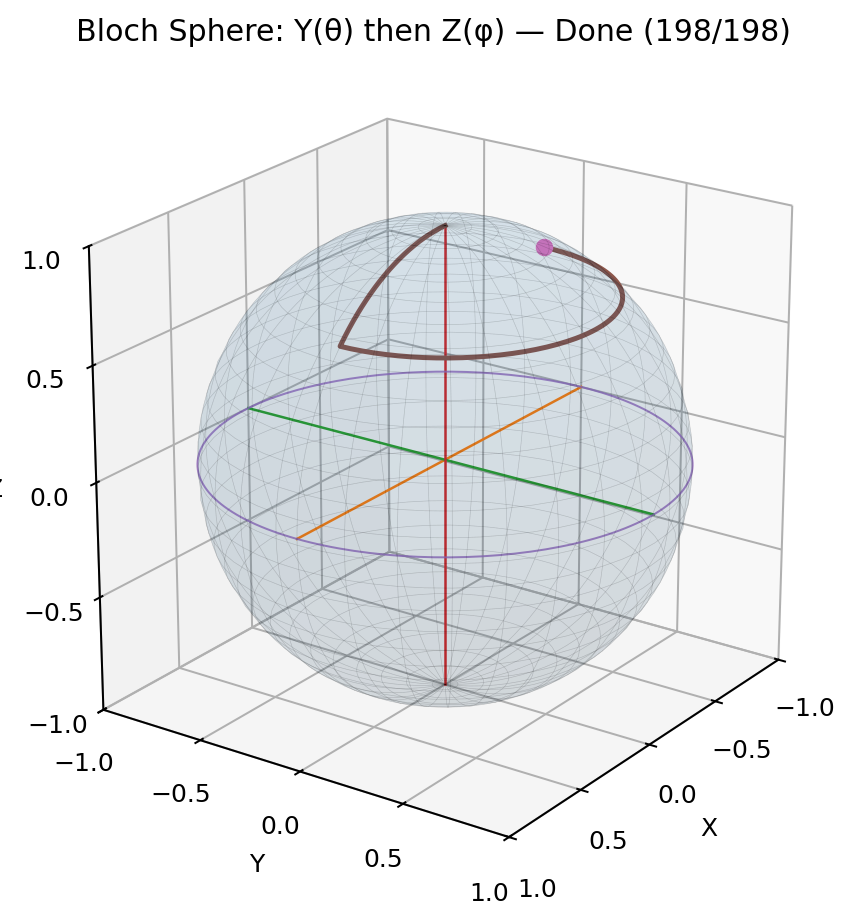

## Optional: Save animation as MP4

In [11]:
# Saving to MP4 requires ffmpeg (usually available on Colab).
if SAVE_MP4:
    print(f"Saving animation to {MP4_PATH} ...")
    from matplotlib.animation import FFMpegWriter
    writer = FFMpegWriter(fps=max(1, int(1000 / INTERVAL_MS)))
    anim.save(MP4_PATH, writer=writer)
    print("Saved.")
else:
    print("Skipping MP4 save; set SAVE_MP4 = True to enable.")

Saving animation to bloch_yz_rotation.mp4 ...
Saved.


## Final State, Probabilities, and Relative Phase

In [12]:

import pandas as pd
from bloch_anim_core import state_results_table

results_df = state_results_table(FINAL_STATE)
results_df


,Component,Amplitude (complex),Magnitude,Probability,Phase (rad),Phase (deg)
0,alpha (|0>),+0.000000000000-0.923879532511j,0.923879532511,0.853553390593,-1.570796326795,-90.000000000000
1,beta (|1>),+0.000000000000+0.382683432365j,0.382683432365,0.146446609407,+1.570796326795,+90.000000000000
2,Relative phase Δ = arg(β) - arg(α),—,—,—,-3.141592653590,-180.000000000000
